# Guide pour l'Appel à une API Hugging Face pour la Segmentation d'Images

Bienvenue ! Ce notebook a pour but de vous guider pas à pas dans l'utilisation de l'API d'inférence de Hugging Face pour effectuer de la segmentation d'images. La segmentation d'images consiste à attribuer une étiquette (comme "cheveux", "vêtement", "arrière-plan") à chaque pixel d'une image.

Nous allons :
1. Comprendre ce qu'est une API et comment s'y connecter.
2. Envoyer une image à un modèle de segmentation hébergé sur Hugging Face.
3. Récupérer et interpréter les résultats.
4. Visualiser les masques de segmentation.
5. Étendre cela pour traiter plusieurs images.

## 1. Configuration Initiale et Importations

Commençons par importer les bibliothèques Python nécessaires. Nous aurons besoin de :
- `os` pour interagir avec le système de fichiers (lister les images).
- `requests` pour effectuer des requêtes HTTP vers l'API.
- `PIL (Pillow)` pour manipuler les images.
- `matplotlib.pyplot` pour afficher les images et les masques.
- `numpy` pour la manipulation des tableaux (les images sont des tableaux de pixels).
- `tqdm.notebook` pour afficher une barre de progression (utile pour plusieurs images).
- `base64` et `io` pour décoder les masques renvoyés par l'API.

In [1]:
import os
import re
import requests
from PIL import Image
import cv2
import matplotlib.pyplot as plt
import numpy as np
from tqdm.notebook import tqdm
import base64
import io
import time
from dotenv import load_dotenv

### Variables de Configuration

Nous devons définir quelques variables :
- `image_dir`: Le chemin vers le dossier contenant vos images. **Assurez-vous de modifier ce chemin si nécessaire.**
- `max_images`: Le nombre maximum d'images à traiter (pour ne pas surcharger l'API ou attendre trop longtemps).
- `api_token`: Votre jeton d'API Hugging Face. **IMPORTANT : Gardez ce jeton secret !**

**Comment obtenir un token API Hugging Face ?**
1. Créez un compte sur [huggingface.co](https://huggingface.co/).
2. Allez dans votre profil -> Settings -> Access Tokens.
3. Créez un nouveau token (par exemple, avec le rôle "read").
4. Copiez ce token ici.

In [2]:
# TODO: Modifiez ces valeurs selon votre configuration
image_dir = "./images_a_segmenter"  # Exemple : si vous êtes sur Colab et avez uploadé un dossier
max_images = 3  # Commençons avec peu d'images

# IMPORTANT: Remplacez "VOTRE_TOKEN_HUGGING_FACE_ICI" par votre véritable token API.
# Ne partagez jamais votre token publiquement.
load_dotenv()
api_token = os.getenv("HF_API_TOKEN")
if not api_token:
    raise ValueError("token non trouvé")
else:
    print("token chargé")

# Créons le dossier d'images s'il n'existe pas (pour l'exemple)
if not os.path.exists(image_dir):
    os.makedirs(image_dir)
    print(f"Dossier '{image_dir}' créé. Veuillez y ajouter des images .jpg ou .png.")
else:
    print(f"Dossier '{image_dir}' existant.")

if api_token == "VOTRE_TOKEN_HUGGING_FACE_ICI":
    print("\nATTENTION : Vous devez remplacer 'VOTRE_TOKEN_HUGGING_FACE_ICI' par votre token API personnel.")

token chargé
Dossier './images_a_segmenter' existant.


## 2. Comprendre l'API d'Inférence Hugging Face

L'API d'inférence permet d'utiliser des modèles hébergés sur Hugging Face sans avoir à les télécharger ou à gérer l'infrastructure.

- **Modèle utilisé** : Nous allons utiliser le modèle `sayeed99/segformer_b3_clothes`, spécialisé dans la segmentation de vêtements et de parties du corps.
- **URL de l'API** : L'URL pour un modèle est généralement `https://api-inference.huggingface.co/models/NOM_DU_MODELE`.
- **Headers (En-têtes)** : Pour s'authentifier et spécifier le type de contenu, nous envoyons des en-têtes avec notre requête.
    - `Authorization`: Contient notre token API (précédé de `Bearer `).
    - `Content-Type`: Indique que nous envoyons une image au format JPEG (ou PNG selon le cas).

In [3]:
def natural_sort_key(filename):
    """
    Trie les noms de fichiers de manière 'naturelle' (numérique).
    Exemple : image_2.png < image_10.png
    """
    return [int(text) if text.isdigit() else text.lower()
            for text in re.split(r'(\d+)', filename)]

In [4]:
API_URL = "https://router.huggingface.co/hf-inference/models/sayeed99/segformer_b3_clothes" # Remplacez ... par le bon endpoint.
headers = {
    "Authorization": f"Bearer {api_token}"
    # Le "Content-Type" sera ajouté dynamiquement lors de l'envoi de l'image
}

# Lister les chemins des images à traiter
# Assurez-vous d'avoir des images dans le dossier 'image_dir'!
image_paths = sorted([os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith(".png")], key=natural_sort_key)


if not image_paths:
    print(f"Aucune image trouvée dans '{image_dir}'. Veuillez y ajouter des images.")
else:
    print(f"{len(image_paths)} image(s) à traiter : {image_paths}")

50 image(s) à traiter : ['./images_a_segmenter/image_0.png', './images_a_segmenter/image_1.png', './images_a_segmenter/image_2.png', './images_a_segmenter/image_3.png', './images_a_segmenter/image_4.png', './images_a_segmenter/image_5.png', './images_a_segmenter/image_6.png', './images_a_segmenter/image_7.png', './images_a_segmenter/image_8.png', './images_a_segmenter/image_9.png', './images_a_segmenter/image_10.png', './images_a_segmenter/image_11.png', './images_a_segmenter/image_12.png', './images_a_segmenter/image_13.png', './images_a_segmenter/image_14.png', './images_a_segmenter/image_15.png', './images_a_segmenter/image_16.png', './images_a_segmenter/image_17.png', './images_a_segmenter/image_18.png', './images_a_segmenter/image_19.png', './images_a_segmenter/image_20.png', './images_a_segmenter/image_21.png', './images_a_segmenter/image_22.png', './images_a_segmenter/image_23.png', './images_a_segmenter/image_24.png', './images_a_segmenter/image_25.png', './images_a_segmenter/i

## 3. Fonctions Utilitaires pour le Traitement des Masques

Le modèle que nous utilisons (`sayeed99/segformer_b3_clothes`) renvoie des masques pour différentes classes (cheveux, chapeau, etc.). Ces masques sont encodés en base64. Les fonctions ci-dessous sont fournies pour vous aider à :
1.  `CLASS_MAPPING`: Un dictionnaire qui associe les noms de classes (ex: "Hat") à des identifiants numériques.
2.  `get_image_dimensions`: Récupérer les dimensions d'une image.
3.  `decode_base64_mask`: Décoder un masque de base64 en une image (tableau NumPy) et le redimensionner.
4.  `create_masks`: Combiner les masques de toutes les classes détectées en un seul masque de segmentation final, où chaque pixel a la valeur de l'ID de sa classe.

**Cette partie est donnée car elle est spécifique au format de sortie de ce modèle et un peu complexe pour une première approche.** Lisez-la pour comprendre son rôle, mais ne vous attardez pas sur les détails d'implémentation pour l'instant.

In [5]:
CLASS_MAPPING = {
    "Background": 0,
    "Hat": 1,
    "Hair": 2,
    "Sunglasses": 3,
    "Upper-clothes": 4,
    "Skirt": 5,
    "Pants": 6,
    "Dress": 7,
    "Belt": 8,
    "Left-shoe": 9,
    "Right-shoe": 10,
    "Face": 11,
    "Left-leg": 12,
    "Right-leg": 13,
    "Left-arm": 14,
    "Right-arm": 15,
    "Bag": 16,
    "Scarf": 17
}

def get_image_dimensions(img_path):
    """
    Get the dimensions of an image.

    Args:
        img_path (str): Path to the image.

    Returns:
        tuple: (width, height) of the image.
    """
    original_image = Image.open(img_path)
    return original_image.size

def decode_base64_mask(base64_string, width, height):
    """
    Decode a base64-encoded mask into a NumPy array.

    Args:
        base64_string (str): Base64-encoded mask.
        width (int): Target width.
        height (int): Target height.

    Returns:
        np.ndarray: Single-channel mask array.
    """
    mask_data = base64.b64decode(base64_string)
    mask_image = Image.open(io.BytesIO(mask_data))
    mask_array = np.array(mask_image)
    if len(mask_array.shape) == 3:
        mask_array = mask_array[:, :, 0]  # Take first channel if RGB
    mask_image = Image.fromarray(mask_array).resize((width, height), Image.NEAREST)
    return np.array(mask_image)

def create_masks(results, width, height):
    """
    Combine multiple class masks into a single segmentation mask.

    Args:
        results (list): List of dictionaries with 'label' and 'mask' keys.
        width (int): Target width.
        height (int): Target height.

    Returns:
        np.ndarray: Combined segmentation mask with class indices.
    """
    combined_mask = np.zeros((height, width), dtype=np.uint8)  # Initialize with Background (0)

    # Process non-Background masks first
    for result in results:
        label = result['label']
        class_id = CLASS_MAPPING.get(label, 0)
        if class_id == 0:  # Skip Background
            continue
        mask_array = decode_base64_mask(result['mask'], width, height)
        combined_mask[mask_array > 0] = class_id

    # Process Background last to ensure it doesn't overwrite other classes unnecessarily
    # (Though the model usually provides non-overlapping masks for distinct classes other than background)
    for result in results:
        if result['label'] == 'Background':
            mask_array = decode_base64_mask(result['mask'], width, height)
            # Apply background only where no other class has been assigned yet
            # This logic might need adjustment based on how the model defines 'Background'
            # For this model, it seems safer to just let non-background overwrite it first.
            # A simple application like this should be fine: if Background mask says pixel is BG, set it to 0.
            # However, a more robust way might be to only set to background if combined_mask is still 0 (initial value)
            combined_mask[mask_array > 0] = 0 # Class ID for Background is 0

    return combined_mask

## 4. Segmentation d'une Seule Image

Avant de traiter toutes les images, concentrons-nous sur une seule pour bien comprendre le processus.

Étapes :
1.  Choisir une image.
2.  Ouvrir l'image en mode binaire (`"rb"`) et lire son contenu (`data`).
3.  Déterminer le `Content-Type` (par exemple, `"image/jpeg"` ou `"image/png"`).
4.  Envoyer la requête POST à l'API avec `requests.post()` en passant l'URL, les headers et les données.
5.  Vérifier le code de statut de la réponse. Une erreur sera levée si le code n'est pas 2xx (succès) grâce à `response.raise_for_status()`.
6.  Convertir la réponse JSON en un dictionnaire Python avec `response.json()`.
7.  Utiliser nos fonctions `get_image_dimensions` et `create_masks` pour obtenir le masque final.
8.  Afficher l'image originale et le masque segmenté.

In [6]:
def afficher_resultats(image_path, mask_array):
    """
    Affiche l'image originale et le masque segmenté côte à côte.
    
    Args:
        image_path (str): Chemin vers l'image originale.
        mask_array (np.ndarray): Masque combiné issu de la segmentation.
    """
    original_image = Image.open(image_path)

    plt.figure(figsize=(12, 6))

    # Image originale
    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title("Image originale")
    plt.axis("off")

    # Masque segmenté
    plt.subplot(1, 2, 2)
    plt.imshow(mask_array, cmap="tab20")
    plt.title("Masque segmenté")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

Traitement de l'image : ./images_a_segmenter/image_0.png
Segmentation réussie !


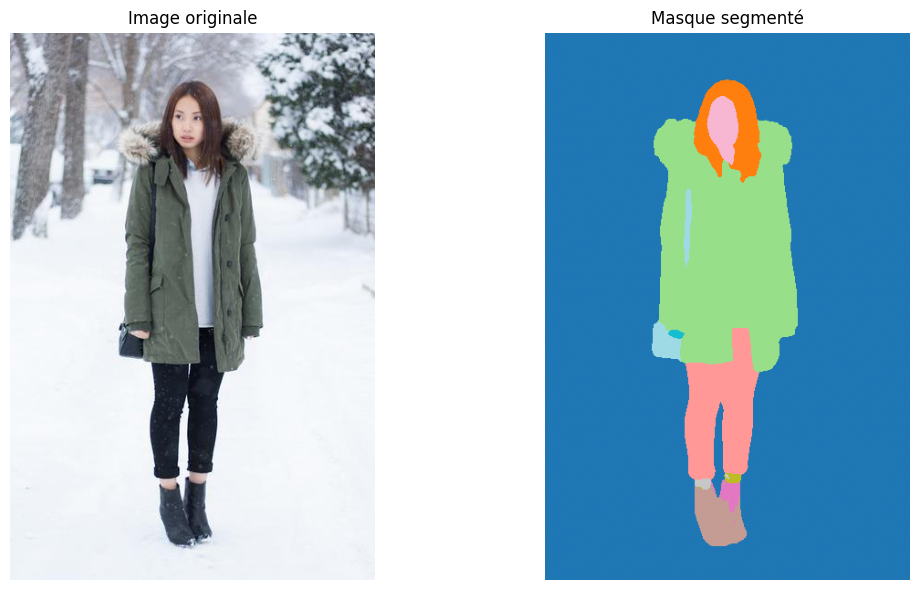

In [7]:
if image_paths:
    single_image_path = image_paths[0] # Prenons la première image de notre liste
    print(f"Traitement de l'image : {single_image_path}")

    try:
        # Ouverture de l'image en mode binaire pour l'envoyer à l'API
        with open(single_image_path, 'rb') as f:
            data = f.read()

        # Requetage de l'API
        response = requests.post(url=API_URL, headers={"Content-Type": "image/png", **headers}, data=data)

        if response.status_code == 200:
            print("Segmentation réussie !")
            # Conversion en JSON
            output = response.json()

            # Obtention du masque
            width, height = get_image_dimensions(single_image_path)
            combined_mask = create_masks(output, width, height)

            # Affichage des résultats
            afficher_resultats(single_image_path, combined_mask)

        else:
            print(f"Erreur dans la segmentation: {response.raise_for_status()}")

    except Exception as e:
                print(f"Une erreur est survenue : {e}")
                
else:
    print("Aucune image à traiter. Vérifiez la configuration de 'image_dir' et 'max_images'.")

## 5. Segmentation de Plusieurs Images (Batch)

Maintenant que nous savons comment traiter une image, nous pouvons créer une fonction pour en traiter plusieurs.
Cette fonction va boucler sur la liste `image_paths` et appliquer la logique de segmentation à chaque image.
Nous utiliserons `tqdm` pour avoir une barre de progression.

In [8]:
!pip install ipywidgets
!jupyter nbextension enable --py widgetsnbextension

usage: jupyter [-h] [--version] [--config-dir] [--data-dir] [--runtime-dir]
               [--paths] [--json] [--debug]
               [subcommand]

Jupyter: Interactive Computing

positional arguments:
  subcommand     the subcommand to launch

options:
  -h, --help     show this help message and exit
  --version      show the versions of core jupyter packages and exit
  --config-dir   show Jupyter config dir
  --data-dir     show Jupyter data dir
  --runtime-dir  show Jupyter runtime dir
  --paths        show all Jupyter paths. Add --json for machine-readable
                 format.
  --json         output paths as machine-readable json
  --debug        output debug information about paths

Available subcommands: dejavu execute kernel kernelspec migrate nbconvert run
troubleshoot trust

Jupyter command `jupyter-nbextension` not found.


In [9]:
def segment_images_batch(list_of_image_paths):
    """
    Segmente une liste d'images en utilisant l'API Hugging Face.

    Args:
        list_of_image_paths (list): Liste des chemins vers les images.

    Returns:
        list: Liste des masques de segmentation (tableaux NumPy).
              Contient None si une image n'a pas pu être traitée.
    """
    batch_segmentations = []

    for idx, image_path in enumerate(
        tqdm(list_of_image_paths, desc="Segmentation des images", unit="image"), start=1
        ):
        print(f"\n[{idx}/{len(list_of_image_paths)}] Traitement de l'image : {image_path}")

        try:
            # Lecture de l'image en binaire
            with open(image_path, 'rb') as f:
                data = f.read()

            # Envoi à l'API Hugging Face
            response = requests.post(
                url=API_URL,
                headers={"Content-Type": "image/png", **headers},
                data=data
            )

            if response.status_code == 200:
                print(" → Segmentation réussie !")

                # Récupération du JSON de sortie
                output = response.json()

                # Dimensions de l'image originale
                width, height = get_image_dimensions(image_path)

                # Création du masque combiné
                combined_mask = create_masks(output, width, height)

                # Ajout du masque à la liste
                batch_segmentations.append(combined_mask)

            else:
                print(f" → Erreur API : {response.status_code}")
                print(response.text)
                batch_segmentations.append(None)

        except Exception as e:
            print(f" → Une erreur est survenue : {e}")
            batch_segmentations.append(None)

        # Pause entre les appels API pour éviter le throttling
        time.sleep(1.5)  # à ajuster selon la limite de requêtes Hugging Face

    return batch_segmentations

# Appeler la fonction pour segmenter les images listées dans image_paths
if image_paths:
    print(f"\nTraitement de {len(image_paths)} image(s) en batch...")
    batch_seg_results = segment_images_batch(image_paths)
    print("Traitement en batch terminé.")
else:
    batch_seg_results = []
    print("Aucune image à traiter en batch.")


Traitement de 50 image(s) en batch...


Segmentation des images:   0%|          | 0/50 [00:00<?, ?image/s]


[1/50] Traitement de l'image : ./images_a_segmenter/image_0.png
 → Segmentation réussie !

[2/50] Traitement de l'image : ./images_a_segmenter/image_1.png
 → Segmentation réussie !

[3/50] Traitement de l'image : ./images_a_segmenter/image_2.png
 → Segmentation réussie !

[4/50] Traitement de l'image : ./images_a_segmenter/image_3.png
 → Segmentation réussie !

[5/50] Traitement de l'image : ./images_a_segmenter/image_4.png
 → Segmentation réussie !

[6/50] Traitement de l'image : ./images_a_segmenter/image_5.png
 → Segmentation réussie !

[7/50] Traitement de l'image : ./images_a_segmenter/image_6.png
 → Segmentation réussie !

[8/50] Traitement de l'image : ./images_a_segmenter/image_7.png
 → Segmentation réussie !

[9/50] Traitement de l'image : ./images_a_segmenter/image_8.png
 → Segmentation réussie !

[10/50] Traitement de l'image : ./images_a_segmenter/image_9.png
 → Segmentation réussie !

[11/50] Traitement de l'image : ./images_a_segmenter/image_10.png
 → Segmentation réussi

## 6. Affichage des Résultats en Batch

Nous allons maintenant créer une fonction pour afficher les images originales et leurs segmentations correspondantes côte à côte, dans une grille.

/tmp/ipykernel_5919/3730027628.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  COLORS = plt.cm.get_cmap('tab20', NUM_CLASSES)


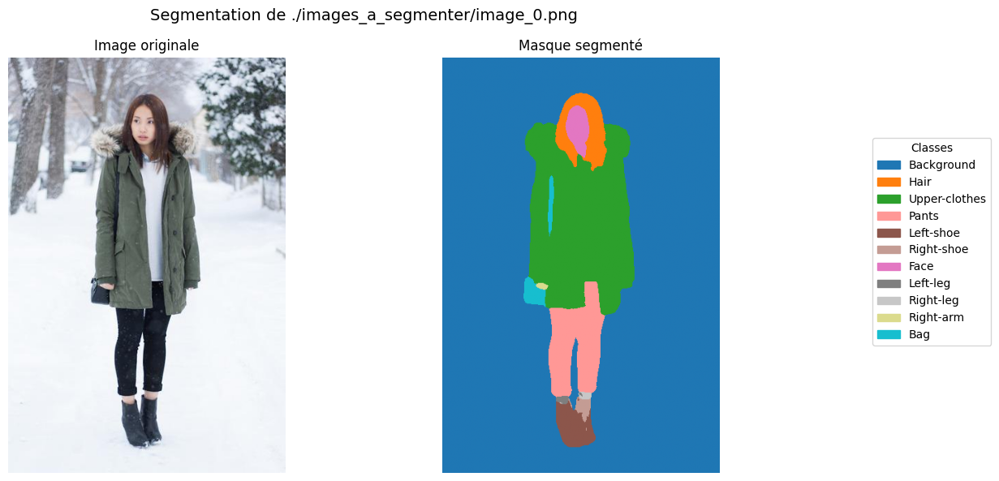

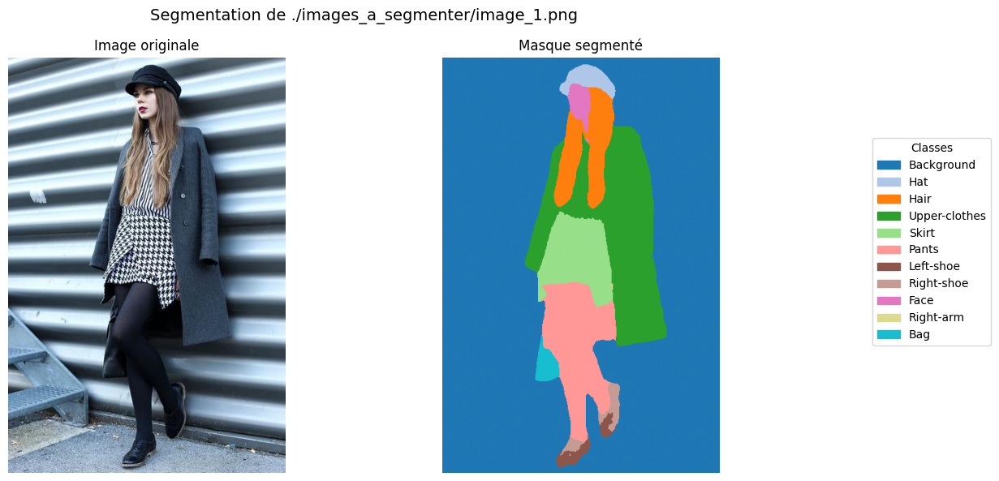

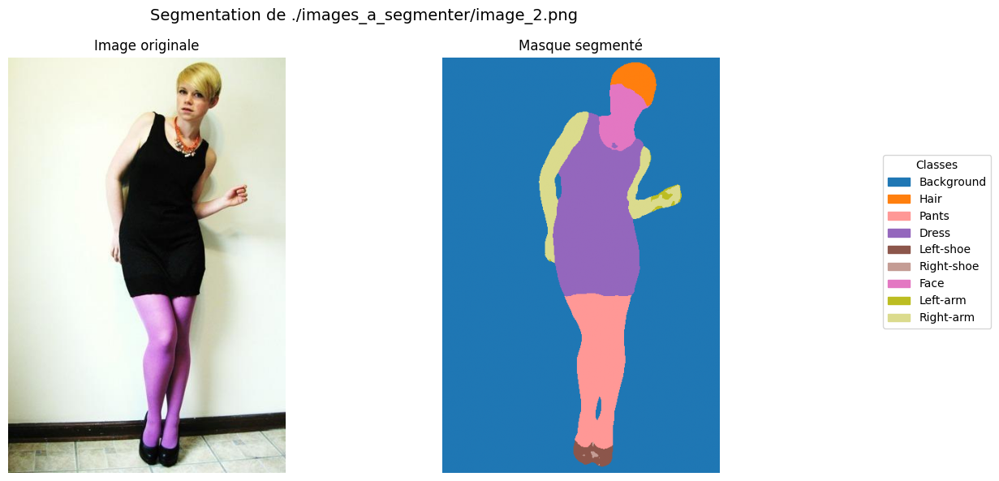

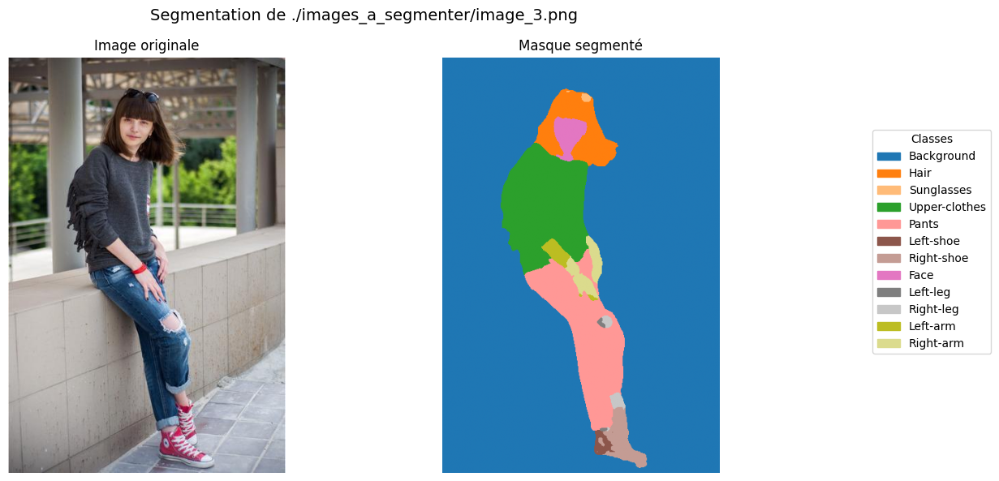

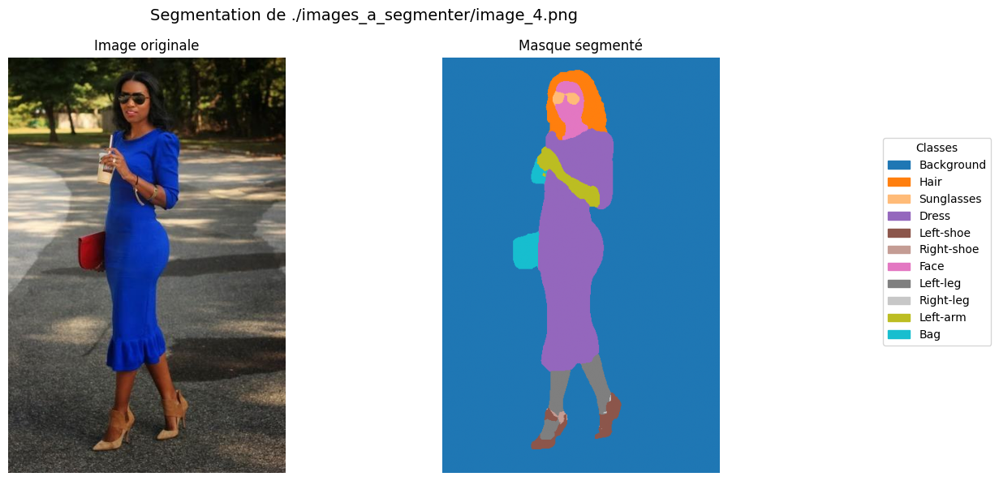

...

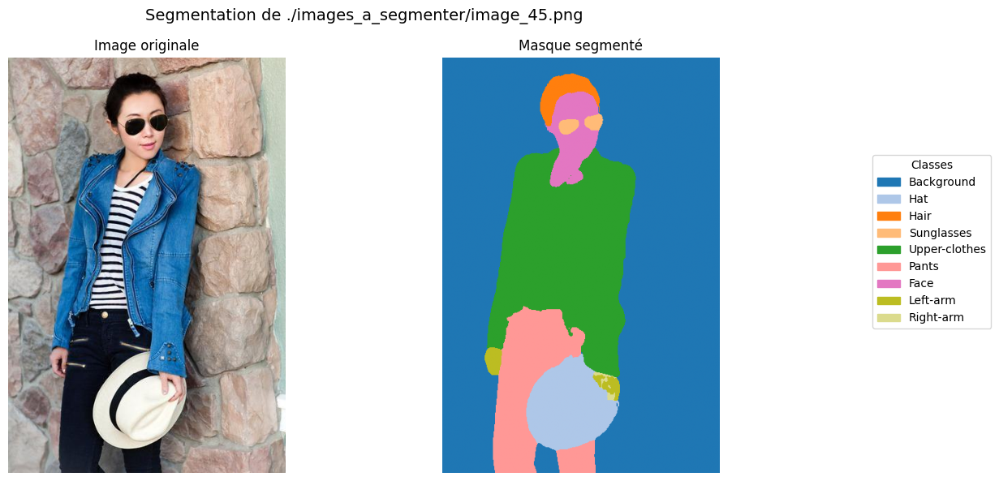

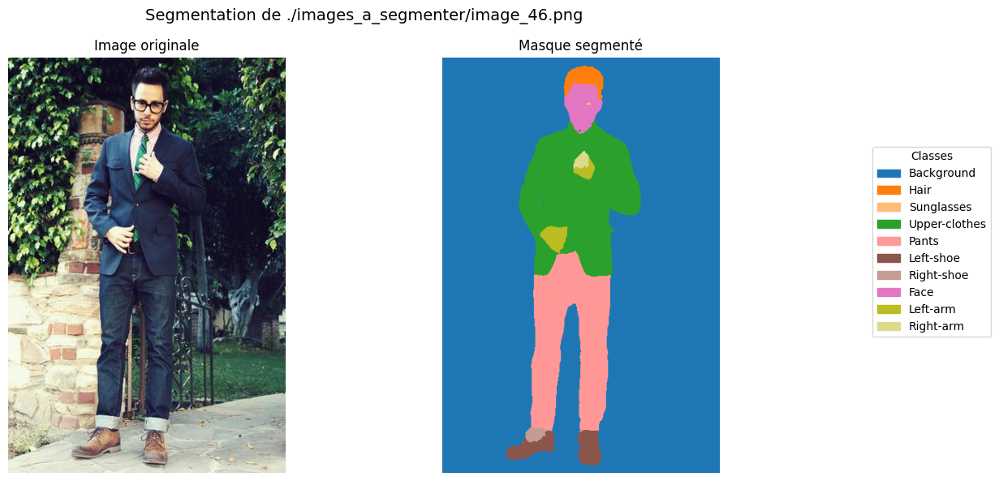

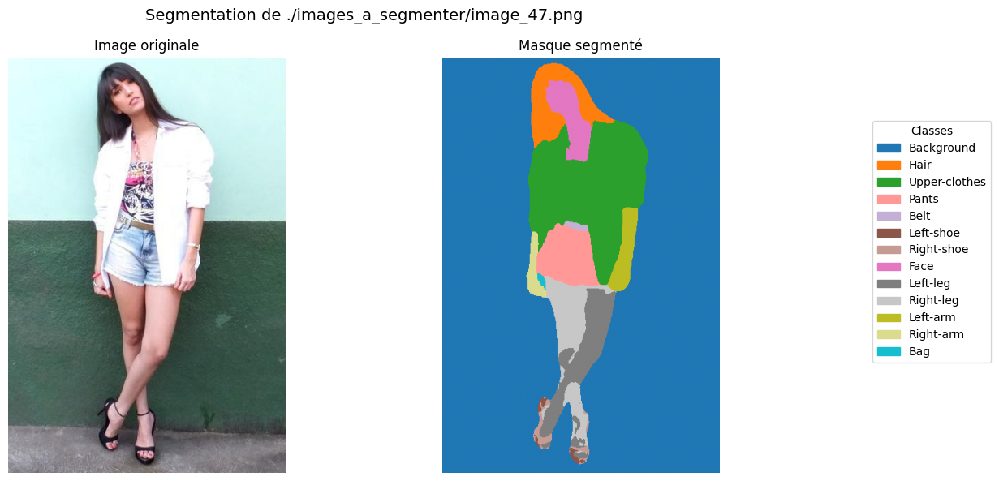

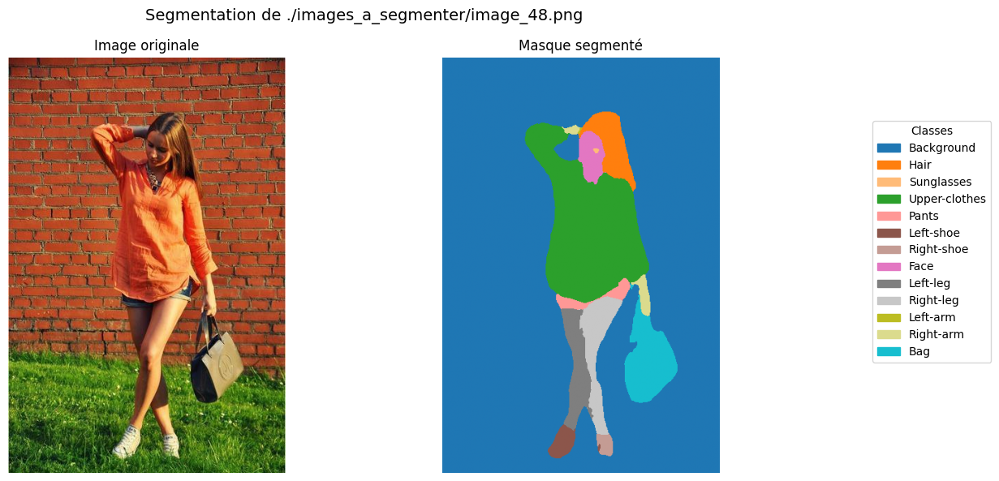

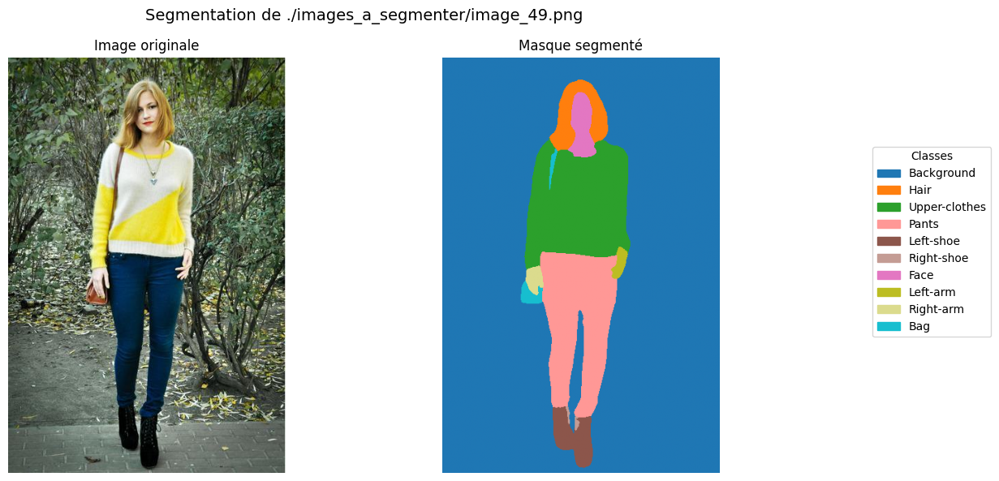

In [10]:
import matplotlib.patches as mpatches
import matplotlib.colors as mcolors

# Générer une palette de couleurs pour les classes
NUM_CLASSES = len(CLASS_MAPPING)
COLORS = plt.cm.get_cmap('tab20', NUM_CLASSES)

# Inverser le dictionnaire pour obtenir les noms par ID
ID_TO_LABEL = {v: k for k, v in CLASS_MAPPING.items()}

def display_segmented_images_batch(original_image_paths, segmentation_masks):
    """
    Affiche les images originales et leurs masques segmentés avec légende des classes.

    Args:
        original_image_paths (list): Liste des chemins des images originales.
        segmentation_masks (list): Liste des masques segmentés (NumPy arrays).
    """
    
    for img_path, mask in zip(original_image_paths, segmentation_masks):
        
        # Lecture de l'image originale
        img = plt.imread(img_path)

        # Création de la figure
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))
        fig.suptitle(f"Segmentation de {img_path}", fontsize=14)

        # Image originale
        axes[0].imshow(img)
        axes[0].set_title("Image originale")
        axes[0].axis("off")

        # Masque segmenté avec colormap
        cmap = COLORS
        norm = mcolors.BoundaryNorm(boundaries=np.arange(NUM_CLASSES+1)-0.5, ncolors=NUM_CLASSES)
        im = axes[1].imshow(mask, cmap=cmap, norm=norm)
        axes[1].set_title("Masque segmenté")
        axes[1].axis("off")

        # Créer la légende
        unique_ids = np.unique(mask)
        patches = [mpatches.Patch(color=cmap(i), label=ID_TO_LABEL.get(i, f"Classe {i}")) for i in unique_ids]
        fig.legend(handles=patches, loc='center right', bbox_to_anchor=(1.15, 0.5), title="Classes")

        plt.tight_layout()
        plt.show()


# Afficher les résultats du batch
if batch_seg_results:
    display_segmented_images_batch(image_paths, batch_seg_results)
else:
    print("Aucun résultat de segmentation à afficher.")

In [11]:
reel_dir = "./masques_reels"
real_mask_paths = sorted([os.path.join(reel_dir, f) for f in os.listdir(reel_dir) if f.endswith(".png")], key=natural_sort_key)

In [12]:
def compute_iou(y_true, y_pred):
    """Calcule l'Intersection over Union (IoU)."""
    intersection = np.logical_and(y_true, y_pred).sum()
    union = np.logical_or(y_true, y_pred).sum()
    return intersection / union if union != 0 else 0

def compute_pixel_accuracy(y_true, y_pred):
    """Exactitude pixel à pixel."""
    return np.mean(y_true == y_pred)

In [13]:
ious, accuracies = [], []

for idx, (pred_mask, real_path) in enumerate(zip(batch_seg_results, real_mask_paths), start=1):
    # Charger le masque réel
    real_mask = np.array(Image.open(real_path))

    # Redimensionner le masque réel si nécessaire
    if pred_mask.shape != real_mask.shape:
        from skimage.transform import resize
        real_mask = resize(real_mask, pred_mask.shape, order=0, preserve_range=True).astype(bool)

    pred_mask = pred_mask.astype(bool)

    # Calcul des métriques
    iou = compute_iou(real_mask, pred_mask)
    acc = compute_pixel_accuracy(real_mask, pred_mask)

    ious.append(iou)
    accuracies.append(acc)

    print(f"[{idx}] IoU={iou:.3f} | Acc={acc:.3f}")

print("Résultats globaux :")
print(f"→ IoU moyen :  {np.mean(ious):.3f}")
print(f"→ Précision pixel : {np.mean(accuracies):.3f}")

[1] IoU=0.951 | Acc=0.782
[2] IoU=0.924 | Acc=0.720
[3] IoU=0.908 | Acc=0.773
[4] IoU=0.949 | Acc=0.803
[5] IoU=0.933 | Acc=0.818
[6] IoU=0.970 | Acc=0.797
[7] IoU=0.968 | Acc=0.805
[8] IoU=0.918 | Acc=0.780
[9] IoU=0.923 | Acc=0.817
[10] IoU=0.914 | Acc=0.486
[11] IoU=0.943 | Acc=0.761
[12] IoU=0.955 | Acc=0.847
[13] IoU=0.943 | Acc=0.825
[14] IoU=0.951 | Acc=0.793
[15] IoU=0.966 | Acc=0.813
[16] IoU=0.951 | Acc=0.783
[17] IoU=0.925 | Acc=0.782
[18] IoU=0.962 | Acc=0.740
[19] IoU=0.917 | Acc=0.824
[20] IoU=0.940 | Acc=0.759
[21] IoU=0.962 | Acc=0.768
[22] IoU=0.955 | Acc=0.414
[23] IoU=0.963 | Acc=0.775
[24] IoU=0.854 | Acc=0.856
[25] IoU=0.959 | Acc=0.827
[26] IoU=0.966 | Acc=0.767
[27] IoU=0.912 | Acc=0.833
[28] IoU=0.961 | Acc=0.823
[29] IoU=0.961 | Acc=0.794
[30] IoU=0.966 | Acc=0.773
[31] IoU=0.970 | Acc=0.776
[32] IoU=0.955 | Acc=0.782
[33] IoU=0.957 | Acc=0.813
[34] IoU=0.966 | Acc=0.766
[35] IoU=0.953 | Acc=0.783
[36] IoU=0.964 | Acc=0.732
[37] IoU=0.952 | Acc=0.804
[38] IoU=0

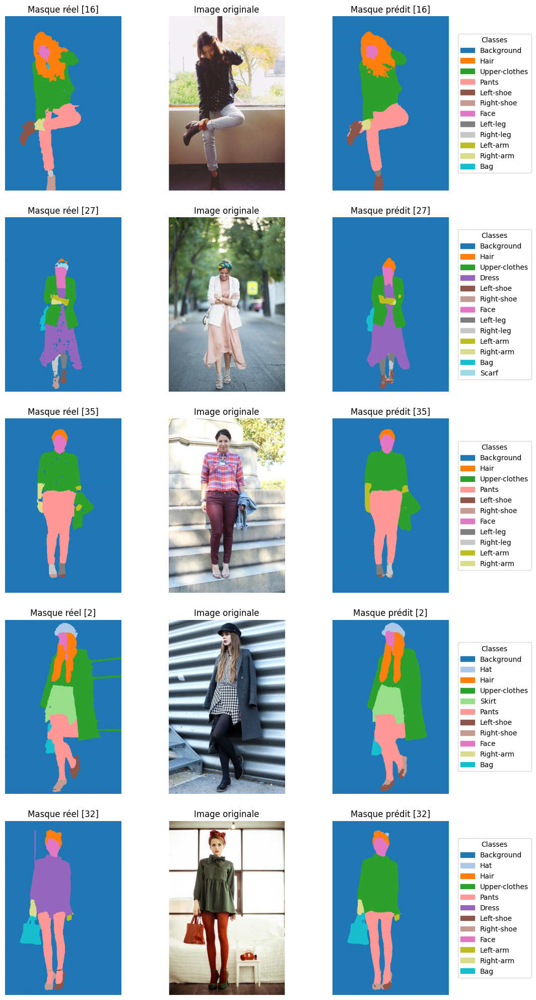

In [14]:

num_samples = 5
sample_indices = np.random.choice(len(batch_seg_results), num_samples, replace=False)

plt.figure(figsize=(12, num_samples * 4))

for i, idx in enumerate(sample_indices):

    pred_mask = batch_seg_results[idx].astype(np.uint8)
    real_mask = np.array(Image.open(real_mask_paths[idx]))

    # Resize si nécessaire
    if pred_mask.shape != real_mask.shape:
        from skimage.transform import resize
        real_mask = resize(real_mask, pred_mask.shape, order=0, preserve_range=True).astype(real_mask.dtype)

    # Normalisation & colormap
    cmap = COLORS
    norm = mcolors.BoundaryNorm(boundaries=np.arange(NUM_CLASSES+1)-0.5, ncolors=NUM_CLASSES)

    # --- Masque réel ---
    ax1 = plt.subplot(num_samples, 3, 3*i + 1)
    im1 = ax1.imshow(real_mask, cmap=cmap, norm=norm)
    ax1.set_title(f"Masque réel [{idx+1}]")
    ax1.axis('off')

    # --- Image originale ---
    img = plt.imread(image_paths[idx])
    ax2 = plt.subplot(num_samples, 3, 3*i + 2)
    ax2.imshow(img)
    ax2.set_title("Image originale")
    ax2.axis('off')

    # --- Masque prédit ---
    ax3 = plt.subplot(num_samples, 3, 3*i + 3)
    im2 = ax3.imshow(pred_mask, cmap=cmap, norm=norm)
    ax3.set_title(f"Masque prédit [{idx+1}]")
    ax3.axis('off')

    # --- Légende (classes présentes) ---
    unique_ids = np.unique(np.concatenate([real_mask.flatten(), pred_mask.flatten()]))
    patches = [
        mpatches.Patch(color=cmap(i), label=ID_TO_LABEL.get(i, f"Classe {i}"))
        for i in unique_ids
    ]

    # Positionner la légende
    plt.legend(
        handles=patches,
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        title="Classes"
    )

plt.tight_layout()
plt.show()

## Conclusion et Prochaines Étapes

Félicitations ! Vous avez appris à :
- Configurer les appels à l'API d'inférence Hugging Face.
- Envoyer des images pour la segmentation.
- Interpréter les résultats (avec l'aide des fonctions fournies).
- Visualiser les segmentations.

Pistes d'amélioration ou d'exploration :
- **Gestion d'erreurs plus fine** : Implémenter des tentatives multiples (retry) en cas d'échec de l'API (par exemple, si le modèle est en cours de chargement).
- **Appels asynchrones** : Pour un grand nombre d'images, des appels asynchrones (avec `asyncio` et `aiohttp`) seraient beaucoup plus rapides.
- **Autres modèles** : Explorer d'autres modèles de segmentation ou d'autres tâches sur Hugging Face Hub.

N'hésitez pas à modifier le code, à tester avec vos propres images et à explorer davantage !

**_Note_** : Si vous aimez ce modèle, n'hésitez pas à le [télécharger](https://huggingface.co/sayeed99/segformer_b3_clothes) et jouer avec directement sur votre machine !